In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import xgboost as xgb
from sklearn.model_selection import TimeSeriesSplit
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, Normalizer

import plotly.express as px
import plotly.graph_objects as go

import os
import re 
from datetime import datetime

import warnings
warnings.filterwarnings('ignore')

sns.set()

C:\Users\dinar\AppData\Local\Temp\ipykernel_4172\765240082.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
def show_plot(df, pred='preds'):
    agg_data = df.copy()
    agg_data.pricing_date = pd.to_datetime(agg_data.pricing_date)
    agg_data.forecast_date = agg_data.forecast_date.astype(str)

    agg_data = agg_data.set_index('pricing_date')

    df = agg_data.copy()
    df = df.sort_index(ascending=True)

    fig = px.line(df, x=df.index, y=pred, color='forecast_date', markers=True, height=600, width=1200)
    fig.update_traces(opacity=0.5, line=dict(width=2, ))

    df = agg_data.copy()
    df = df.sort_index(ascending=True)

    x = df.index
    y = df['target']
    name = 'target'
    fig.add_trace(
        go.Scatter(x=x, y=y, name=name, mode='lines+markers', opacity=0.5, marker=dict(color='darkgray', size=10),
                   line=dict(width=18, color='gray')))  # ,shape = 'hv'
    fig.show()
    

def show_results(results, save_path):
    thresh = 0.2

    results['nth_day'] = results.groupby('forecast_date')['preds'].cumcount()
    results['preds_diff'] = results.groupby('forecast_date')['preds'].diff()
    results['traget_diff'] = results.groupby('forecast_date')['target'].diff()
    results['preds_diff_cum'] = results.groupby('forecast_date')['preds_diff'].cumsum()
    results['traget_diff_cum'] = results.groupby('forecast_date')['traget_diff'].cumsum()
    results['preds_direct'] = results['preds_diff'].apply(lambda x: 1 if x > 0 else (-1 if x < 0 else 0))
    results['traget_direct'] = results['traget_diff'].apply(lambda x: 1 if x > 0 else (-1 if x < 0 else 0))
    results['preds_direct_cum'] = results['preds_diff_cum'].apply(
        lambda x: 1 if x > thresh else (-1 if x < -thresh else 0))
    results['traget_direct_cum'] = results['traget_diff_cum'].apply(
        lambda x: 1 if x > thresh else (-1 if x < -thresh else 0))
    results['pnl_stra_daily_direct'] = results['preds_direct'] * results['traget_diff']
    results['pnl_stra_cum_direct'] = results['preds_direct_cum'] * results['traget_diff_cum']

    fig, ax = plt.subplots(1, 2, figsize=(12, 6), sharex=True, sharey=True)
    results.pivot_table(index='pricing_date', values='pnl_stra_cum_direct', aggfunc=sum).cumsum().plot(ax=ax[0],
                                                                                                       title='pnl_stra_cum_direct')
    results.pivot_table(index='pricing_date', values='pnl_stra_daily_direct', aggfunc=sum).cumsum().plot(ax=ax[1],
                                                                                                         title='pnl_stra_daily_direct')
    fig.show()

In [3]:
def iterate(data, idx, step=100, low=False):
    # change step size if we have smaller input data
    step = 50 if low else 100

    # select starting point depending on the size of the input data
    start = idx * step if idx > 0 else 0

    # select ending point (if smaller, 300 days rolling window. Otherwise, 600)
    if low:
        end = 300 + step * idx
    else:
        end = 600 + step * idx

    train, val = data.iloc[start: start + end - 30, :], data.iloc[start + end - 30: start + end, :]
    return train, val


def custom_pnl_10(y_pred, y_true):
    nth = 10

    thresh = 0.2
    try:
        diff = y_pred[nth - 1] - y_pred[0]
    except IndexError:
        diff = y_pred[-1] - y_pred[0]

    direction = 1 if diff > thresh else (-1 if diff < thresh else 0)
    pnl = diff * direction

    return 'pnl', pnl



In [4]:
from statsmodels.tsa.seasonal import seasonal_decompose

class TargetFeature:
    def __init__(self, results_path, data, test_start, test_end, target='F380 M2/M3',
                 features=None, **kwargs):
        self.results_path = results_path

        self.data = data
        self.test_start = test_start
        self.test_end = test_end
        self.target = target
        self.features = features

        # define pd.DataFrame to store resulting df
        self.target_and_feature = None

        # define scaler
        self.scaler = MinMaxScaler()

        # define a starting message for log
        self.message = 'Task 2 [TargetFeature]:\n\t'

    def __call__(self, *args, **kwargs):
        self._setup()

    def _setup(self):
        # self.log(self.log_path, f'{self.message}Internal setup for target and feature columns...')
        target = self.data[self.target]
        target.interpolate(inplace=True)
        target.dropna(inplace=True)
        
        self.target_and_feature = pd.DataFrame(index=self.data.index)
        self.target_and_feature['actual_target'] = target
        self.target_and_feature['predicted_target'] = target
        
        if self.features is not None:
        
            print('TargetFeature:', self.target_and_feature)
            
            decompose = seasonal_decompose(target, model='additive', period=4)
            
            for feature in self.features:
                if feature in ['rolling', 'all']:
                    rolling = self.data[self.target].rolling(5).mean()
                    self.target_and_feature['actual_rolling'] = rolling[:self.test_end]
                    self.target_and_feature['predicted_rolling'] = rolling[:self.test_start]
                # if feature in ['trend', 'all']:
                #     self.target_and_feature['actual_trend'] = decompose.trend
                #     self.target_and_feature['predicted_trend'] = self.target_and_feature['actual_trend'][:self.test_start]
                if feature in ['seasonality', 'all']:
                    self.target_and_feature['actual_seasonality'] = decompose.seasonal
                if feature in ['fft', 'all']:
                    fft_value = np.fft.fft(target)
                    self.target_and_feature['actual_fft_real'] = fft_value.real
                    self.target_and_feature['predicted_fft_real'] = self.target_and_feature['actual_fft_real'][:self.test_start]
                    self.target_and_feature['actual_fft_imag'] = fft_value.imag
                    self.target_and_feature['predicted_fft_imag'] = self.target_and_feature['actual_fft_imag'][:self.test_start]
                if feature in ['diff', 'all']:
                    self.target_and_feature['actual_diff'] = target.diff()
                    self.target_and_feature['predicted_diff'] = self.target_and_feature['actual_diff'][:self.test_start]
                if feature in ['seasonal_diff', 'all']:
                    self.target_and_feature['actual_seasonal_diff'] = decompose.seasonal.diff()
                if feature in ['ewm', 'all']:
                    self.target_and_feature['actual_ewm'] = target.ewm(span=30, adjust=True).mean()
                    self.target_and_feature['predicted_ewm'] = self.target_and_feature['actual_ewm'][:self.test_start]
            
            # self.target_and_feature.dropna(inplace=True)
            print('TargetFeature updated:', self.target_and_feature)

            # fit a scaler
            columns = [x for x in self.target_and_feature if 'predicted' not in x and 'target' not in x]
            self.scaler.fit(self.target_and_feature[columns])


    def get_target_feature(self, end_date, start_date=None, include_past=False):
        # return all values until specified date
        if include_past:
            if start_date is not None:
                # self.log(self.log_path, f'Returning dates from {start_date} to {end_date}.')
                return self.target_and_feature.loc[start_date:end_date, :]
            # self.log(self.log_path, f'Returning all dates until {end_date}')
            return self.target_and_feature.loc[:end_date, :]

        # return one-day results
        try:
            entry = pd.DataFrame(self.target_and_feature.loc[end_date, :]).T
        except KeyError:
            # self.log(self.log_path, f'{self.message}Date {end_date} does not exist!', CRITICAL)
            raise KeyError(f'{self.message}Date {end_date} does not exist!')
        else:
            # self.log(self.log_path, f'Returned one-day instance for {end_date}.')
            return entry

    def set_target_feature(self, date, column, value):
        fmt = '%Y-%m-%d'

        # raise error if the supplemented date is less than the test start
        # if datetime.strptime(self.test_start, fmt) < datetime.strptime(date, fmt):
        #     message = f'Illegal date substitution {date}, expected to see dates between {self.test_start} to {date}.'
        #     self.log(self.log_path, self.message + message, CRITICAL)
        #     raise Exception(message)

        # get previous value
        previous = self.target_and_feature.loc[date, column]

        # log information
        # self.log(self.log_path, f'{self.message}Setting new value for {column}. Old: {previous}, new: {value}')

        # set new value
        self.target_and_feature.loc[date, column] = value

        # save current state
        # self.target_and_feature.reset_index(inplace=True)
        self.target_and_feature.to_csv(f'{self.results_path}/complete_target_feature_df.csv', index=True)
        # self.log(self.log_path, f'{self.message}Saving intermediate results in {self.results_path} CSV file.')


In [30]:
def train_model(data, test_start, test_end=None, target_col='F380 M2/M3', model_suffix='full', columns=None, final_refit=True, path=None, 
                use_features=False, n_estimators=1500, target_features=None):
    if columns is None and model_suffix == 'full':
        columns = [x for x in data.columns if x != target_col]
    elif columns is None and model_suffix != 'full':
        raise ValueError('Cannot train a subset of columns without specifying them! Please pass the columns ')
    
    # set the model name
    today_date = str(datetime.now())[:10]
    
    data.interpolate('linear', inplace=True)
    data.dropna(inplace=True)
    
    # create a target feature class
    if target_features is None:
        target_feature = TargetFeature(path, data, test_start, test_end, features=None)
    else:
        target_features = [target_features] if isinstance(target_features, str) else target_features
        target_feature = TargetFeature(path, data, test_start, test_end, features=target_features)
    target_feature()
    
    # drop target column
    data.drop(columns=[target_col], inplace=True)
    
    # data = data[columns]
    print('Data columns:', data.columns)
    
    # split to train/test
    train = data[data.index < test_start]
    
    if test_end:
        test = data[(data.index >= test_start) & (data.index < test_end)]
    else:
        test = data[data.index < test_end]
        
    # initiate normalization 
    scaler = MinMaxScaler()
    scaler.fit(train)
    
    # normalize data
    train = pd.DataFrame(scaler.transform(train), index=train.index, columns=train.columns)
    test = pd.DataFrame(scaler.transform(test), index=test.index, columns=train.columns)
    
    # get names for target_feature columns
    rolling, target = 'actual_feature', 'actual_target'
    
    # set parameters
    params = {'process_type': 'default', 'refresh_leaf': True, 'min_child_weight': 7,
              'subsample': 1, 'colsample_bytree': 0.5, 'eta': 0.03}
    
    if use_features:
    
        all_target_cols = ['actual_rolling', 'actual_seasonality', 'actual_fft_real', 'actual_fft_imag', 'actual_diff', 'actual_seasonal_diff', 'actual_ewm']
        all_pred_target_cols = ['predicted_rolling', 'predicted_fft_real', 'predicted_fft_imag', 'predicted_diff', 'predicted_ewm']

        current_target_cols = [col for col in all_target_cols if any(target in col for target in target_features)] if target_features != ['all'] else all_target_cols
        current_pred_target_cols = [col for col in all_pred_target_cols if any(target in col for target in target_features)] if target_features != ['all'] else all_pred_target_cols
        
        model_name = f'experiments/models/model-{model_suffix}-cols={len(columns) + len(current_target_cols)}_estim={n_estimators}.model'
    else:
        model_name = f'experiments/models/model-{model_suffix}-cols={len(columns)}_estim={n_estimators}.model'
    
    # start pretraining the model
    for idx in range(300):
        # get batches
        train_temp, valid_temp = iterate(train, idx, low=False)

        # break if there are fewer values
        if len(train_temp) < 200 or len(valid_temp) <= 5: break

        # get rolling and target columns
        if use_features:
            train_temp[[target_col] + current_target_cols] = \
                target_feature.get_target_feature(end_date=train_temp.index.max(), start_date=train_temp.index.min(),
                                                include_past=True)[[target] + current_target_cols].values
            valid_temp[[target_col] + current_target_cols] = \
                target_feature.get_target_feature(end_date=valid_temp.index.max(), start_date=valid_temp.index.min(),
                                                include_past=True)[[target] + current_target_cols].values

            train_temp.replace([np.inf, -np.inf], np.nan, inplace=True)
            valid_temp.replace([np.inf, -np.inf], np.nan, inplace=True)
            train_temp.dropna(inplace=True)
            valid_temp.dropna(inplace=True)
            
            y_train = train_temp[target_col]
            y_test = valid_temp[target_col]
            
            train_temp.drop(columns=target_col, inplace=True)
            valid_temp.drop(columns=target_col, inplace=True)

            # normalize rolling
            train_temp[current_target_cols] = target_feature.scaler.transform(train_temp[current_target_cols])
            valid_temp[current_target_cols] = target_feature.scaler.transform(valid_temp[current_target_cols])

        else:
            y_train = target_feature.get_target_feature(end_date=train_temp.index.max(), start_date=train_temp.index.min(),
                                                include_past=True)[target].values
            y_test = target_feature.get_target_feature(end_date=valid_temp.index.max(), start_date=valid_temp.index.min(),
                                                include_past=True)[target].values

        print(train_temp.shape, y_train.shape)
        print(valid_temp.shape, y_test.shape)

        if idx == 0:
            model = xgb.XGBRegressor(n_estimators=n_estimators, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist')
            model.fit(train_temp, y_train, eval_set=[(valid_temp, y_test)], early_stopping_rounds=15, verbose=False)
            
        else:
            model = xgb.XGBRegressor(n_estimators=n_estimators, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', xgb_model=model_name)
            model.load_model(model_name)
            model.fit(train_temp, y_train, eval_set=[(valid_temp, y_test)], early_stopping_rounds=15, verbose=False)

        model.save_model(model_name)

    # final refit
    full_train = train.copy()
    
    if use_features:
        full_train[[target_col] + current_target_cols] = target_feature.get_target_feature(end_date=train.index.max(),
                                                                                           include_past=True)[[target] + current_target_cols].values

    else:
        full_train[target_col] = target_feature.get_target_feature(end_date=train.index.max(), include_past=True)[target].values
        
    full_train.replace([np.inf, -np.inf], np.nan, inplace=True)
    full_train.dropna(inplace=True)
    
    y_train = full_train[target_col]
    full_train.drop(columns=target_col, inplace=True)

    if use_features:
        # normalize data
        full_train[current_target_cols] = target_feature.scaler.transform(full_train[current_target_cols])
    
    model = xgb.XGBRegressor(n_estimators=n_estimators, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', xgb_model=model_name)
    model.load_model(model_name)
    model.fit(full_train, y_train, verbose=False)

    model.save_model(model_name)

    if use_features:
        return model, train, test, scaler, target_feature, current_target_cols, current_pred_target_cols
    
    return model, train, test, scaler, target_feature


def get_columns(columns_selection, model):
    if columns_selection == 'xgboost':
        scores = model.get_score(importance_type='gain')
        temp_df = pd.DataFrame({'columns': scores.keys(), 'values': scores.values()})
        return temp_df[temp_df['values'] > 30]['columns'].to_list()


def get_predictions(data, results_folder, test_start, test_end, columns_selection='xgboost', use_features=False, n_estimators=1500, target_features=None, use_fe=False):
    if use_fe:
        model, train, test, scaler, target_feature = train_model(data.copy(), test_start=test_start, test_end=test_end, 
                                                                 columns=data.columns, path=results_folder, 
                                                                 use_features=False, n_estimators=n_estimators, target_features=None)

        columns = get_columns(columns_selection, model)
        print(columns)
        columns = [x for x in columns if not x.startswith('rolling')]
        print('Selected columns:', columns)
    else:
        columns = data.drop(columns='F380 M2/M3').columns
        print('Selected columns:', columns)
    
    # refit the model with selected columns
    model, train, test, scaler, target_feature, current_target_cols, current_pred_target_cols = train_model(data.copy(), test_start=test_start, test_end=test_end, 
                                                                                                model_suffix='partial', columns=columns, path=results_folder, 
                                                                                                use_features=use_features, n_estimators=n_estimators, target_features=target_features)
    
    window_size = 10
    results_df = pd.DataFrame(columns=['pricing_date', 'preds', 'target', 'forecast_date'])
    market_data = data.copy()

    for counter in range(len(test)):
        try:
            sliding_history = market_data[market_data.index >= test_start].iloc[counter: counter + window_size, :]
        except IndexError:
            pass
        else:
            # verify the length of the sliding history == window_size
            if len(sliding_history) < window_size:
                break

            # copy original data
            full_history = market_data.copy()

            # keep track of every 0th value to select all actual targets and then predictions afterward
            first_day, second_day = None, None

            for counter2 in range(window_size):
                try:
                    sliding_start_date = pd.DataFrame(sliding_history.iloc[counter2, :]).T.index.values[0]

                    if counter2 == 1:
                        second_day = sliding_start_date

                except IndexError:
                    pass
                else:
                    tfeatures = []
                    
                    expanding_history = full_history[full_history.index <= sliding_start_date]

                    # get test value and convert to DMatrix
                    testx = pd.DataFrame(expanding_history.iloc[-1, :]).T
                    testx = testx[columns]

                    # normalize features
                    testx = pd.DataFrame(scaler.transform(testx), columns=testx.columns, index=testx.index)

                    # select current state of the target/feature dataframe
                    current_values = target_feature.get_target_feature(sliding_start_date, include_past=True)
                    
                    # select actual values for the first predictions
                    if counter2 == 0:
                        current_targets = current_values['actual_target']
                    else:
                        current_targets = current_values['actual_target'].copy()
                        current_targets.loc[second_day:sliding_start_date] = current_values['predicted_target'].loc[
                                                                             second_day:sliding_start_date]
                    if use_features:
                        print('Current targets:', current_targets, end='\n\n\n')
                        decompose = seasonal_decompose(current_targets, model='additive', period=4)
                        fft_value = np.fft.fft(current_targets)
                        
                        print('Decompose:', decompose.trend)
                        
                        features = pd.DataFrame(index=current_targets.index)
                        
                        for feature in current_target_cols:                            
                            if feature == 'actual_rolling':
                                method = current_targets.rolling(5).mean()
                            if feature == 'actual_ewm':
                                method = current_targets.ewm(span=30, adjust=True).mean()
                            if feature == 'actual_trend':
                                method = decompose.trend
                            if feature == 'actual_seasonality':
                                method = current_values['actual_seasonality']
                            if feature == 'actual_fft_imag':
                                method = fft_value.imag 
                            if feature == 'actual_fft_real':
                                method = fft_value.real
                            if feature == 'actual_diff':
                                method = current_targets.diff()
                            if feature == 'actual_seasonal_diff':
                                method = decompose.seasonal.diff()
                            
                            features[feature] = method
                        
                        # features.dropna(inplace=True)
                        
                        try:
                            features = pd.DataFrame(target_feature.scaler.transform(features), index=features.index, columns=features.columns)
                            features = features.loc[:sliding_start_date]
                        except ValueError:
                            pass
                        
                        print('FEATURES:', features)
                        
                        for col in features.columns:
                            print(features.loc[sliding_start_date, col])
                            testx[col] = features.loc[sliding_start_date, col]

                    # get predictions
                    prediction = model.predict(testx)

                    # append new prediction to predicted target column
                    target_feature.set_target_feature(str(sliding_start_date)[:10], 'predicted_target', prediction)

                    if use_features:
                        print('tfeatures', tfeatures)
                        print(testx)
                        print('current_target_cols', current_target_cols)
                        inverse = target_feature.scaler.inverse_transform(testx[current_target_cols])
                        
                        print(inverse)
                        
                        for idx, feature in enumerate(current_target_cols):
                            target_feature.set_target_feature(str(sliding_start_date)[:10], feature, inverse[0][idx])

                    # record results
                    results_df = pd.concat([results_df, pd.DataFrame({
                        'pricing_date': testx.index,
                        'preds': prediction,
                        'target': current_values.loc[sliding_start_date, 'actual_target'],
                        'forecast_date': sliding_history.index.min()

                    })], ignore_index=True)
    results_df.to_csv(f'{results_folder}/results-for-{test_start}.csv')
    show_results(results_df, f'{results_folder}/daily_pnl-for-{test_start}.png')
    show_plot(results_df)

    return {'results_df': results_df, 'pnl_path': f'{results_folder}/daily_pnl-for-{test_start}.png',
            'plot_path': f'{results_folder}/plot-for-{test_start}.png', 'model': model}

In [ ]:
data = pd.read_csv('data/data_2024-02-02.csv')
data.pricing_date = pd.to_datetime(data.pricing_date)
data.set_index('pricing_date', inplace=True)

data['year_sin'] = np.sin(data.index.year / data.index.year.max() * 2 * np.pi)
data['month_sin'] = np.sin(data.index.month / data.index.month.max() * 2 * np.pi)
data['day_sin'] = np.sin(data.index.day / data.index.day.max() * 2 * np.pi)
data['dow_sin'] = np.sin(data.index.dayofweek / data.index.dayofweek.max() * 2 * np.pi)


data['year_num'] = data.index.year
data['month_num'] = data.index.month
data['day_num'] = data.index.day
data['dow_num'] = data.index.dayofweek

data

In [ ]:
path = 'experiments/test'

if not os.path.exists(path): os.mkdir(path)

path += '/estimators/'
if not os.path.exists(path): os.mkdir(path)

data.interpolate('linear', inplace=True)
data.dropna()

results = get_predictions(data.copy(), path, '2023-01-01', '2023-12-31', use_features=True, n_estimators=100, target_features=['all'])

In [ ]:
from explainerdashboard import RegressionExplainer, ExplainerDashboard
import xgboost as xgb

model_name = 'experiments/models/model-partial-cols=74_estim=100.model'

model = xgb.XGBRegressor(n_estimators=1500, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', xgb_model=model_name)
model.load_model(model_name)

X_test = data.loc[:'2023-01-01'].drop(columns='F380 M2/M3')
y_test = data.loc[:'2023-01-01']['F380 M2/M3']

tf = TargetFeature(path, data, '2023-01-01', '2023-12-31', features=['all'])
tf()
targ_features = tf.get_target_feature('2023-01-01', include_past=True)
cols = [x for x in targ_features.columns if 'predicted' not in x and 'target' not in x]
X_test[cols] = targ_features[cols]

explainer = RegressionExplainer(model, X_test, y_test)

In [ ]:
ExplainerDashboard(explainer, simple=True).run()

# Rolling + ewm

In [ ]:
path = 'experiments/test'

if not os.path.exists(path): os.mkdir(path)

path += '/estimators/'
if not os.path.exists(path): os.mkdir(path)

data.interpolate('linear', inplace=True)
data.dropna()

results = get_predictions(data.copy(), path, '2023-01-01', '2023-12-31', use_features=True, n_estimators=100, target_features=['rolling', 'ewm'])

In [ ]:
from explainerdashboard import RegressionExplainer, ExplainerDashboard
import xgboost as xgb

path = 'experiments/test'

if not os.path.exists(path): os.mkdir(path)

path += '/estimators/'
if not os.path.exists(path): os.mkdir(path)

data.interpolate('linear', inplace=True)
data.dropna()

model_name = 'experiments/models/model-partial-cols=74_estim=100.model'

model = xgb.XGBRegressor(n_estimators=1500, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', xgb_model=model_name)
model.load_model(model_name)

X_test = data.loc['2023-01-01':'2024-01-01'].drop(columns='F380 M2/M3')
y_test = data.loc['2023-01-01':'2024-01-01']['F380 M2/M3']

pred_target = pd.read_csv('experiments/test/estimators/complete_target_feature_df.csv')
pred_target.pricing_date = pd.to_datetime(pred_target.pricing_date)
pred_target.set_index('pricing_date', inplace=True)

X_test[['actual_rolling', 'actual_ewm']] = pred_target.loc['2023-01-01':'2024-01-01'][['actual_rolling', 'actual_ewm']]
X_test


In [ ]:
# tf = TargetFeature(path, data, '2023-01-01', '2023-12-31', features=['rolling', 'ewm'])
# tf()
# targ_features = tf.get_target_feature('2023-01-01', include_past=True)
# cols = [x for x in targ_features.columns if 'predicted' not in x and 'target' not in x]
# X_test[cols] = targ_features[cols]

explainer = RegressionExplainer(model, X_test, y_test)
ExplainerDashboard(explainer, depth=10).run()

# Expanding to include feature engineering

In [60]:
def train_model(data, test_start, test_end=None, target_col='F380 M2/M3', model_suffix='full', columns=None, final_refit=True, path=None, 
                use_features=False, n_estimators=1500, target_features=None):
    if columns is None and model_suffix == 'full':
        columns = [x for x in data.columns if x != target_col]
    elif columns is None and model_suffix != 'full':
        raise ValueError('Cannot train a subset of columns without specifying them! Please pass the columns ')
    
    # set the model name
    today_date = str(datetime.now())[:10]
    
    data.interpolate('linear', inplace=True)
    data.dropna(inplace=True)
    
    # create a target feature class
    if target_features is None:
        target_feature = TargetFeature(path, data, test_start, test_end, features=None)
    else:
        target_features = [target_features] if isinstance(target_features, str) else target_features
        target_feature = TargetFeature(path, data, test_start, test_end, features=target_features)
    target_feature()
    
    
    print('COLUMNS', columns)
    
    # drop target column
    data.drop(columns=[target_col], inplace=True)
    
    if target_col in columns:
        columns = list(columns)
        columns.remove(target_col)
    
    if len(columns) > 1:
        data = data[columns]
    
    # split to train/test
    train = data[data.index < test_start]
    
    if test_end:
        test = data[(data.index >= test_start) & (data.index < test_end)]
    else:
        test = data[data.index < test_end]
        
    # initiate normalization 
    scaler = MinMaxScaler()
    scaler.fit(train)
    
    # normalize data
    train = pd.DataFrame(scaler.transform(train), index=train.index, columns=train.columns)
    test = pd.DataFrame(scaler.transform(test), index=test.index, columns=train.columns)
    
    # get names for target_feature columns
    rolling, target = 'actual_feature', 'actual_target'
    
    # set parameters
    params = {'process_type': 'default', 'refresh_leaf': True, 'min_child_weight': 7,
              'subsample': 1, 'colsample_bytree': 0.5, 'eta': 0.03}
    
    if use_features:
    
        all_target_cols = ['actual_rolling', 'actual_seasonality', 'actual_fft_real', 'actual_fft_imag', 'actual_diff', 'actual_seasonal_diff', 'actual_ewm']
        all_pred_target_cols = ['predicted_rolling', 'predicted_fft_real', 'predicted_fft_imag', 'predicted_diff', 'predicted_ewm']

        current_target_cols = [col for col in all_target_cols if any(target in col for target in target_features)] if target_features != ['all'] else all_target_cols
        current_pred_target_cols = [col for col in all_pred_target_cols if any(target in col for target in target_features)] if target_features != ['all'] else all_pred_target_cols
        
        model_name = f'experiments/models/model-{model_suffix}-cols={len(columns) + len(current_target_cols)}_estim={n_estimators}.model'
    else:
        model_name = f'experiments/models/model-{model_suffix}-cols={len(columns)}_estim={n_estimators}.model'
    
    # start pretraining the model
    for idx in range(300):
        # get batches
        train_temp, valid_temp = iterate(train, idx, low=False)

        # break if there are fewer values
        if len(train_temp) < 200 or len(valid_temp) <= 5: break

        # get rolling and target columns
        if use_features:
            train_temp[[target_col] + current_target_cols] = \
                target_feature.get_target_feature(end_date=train_temp.index.max(), start_date=train_temp.index.min(),
                                                include_past=True)[[target] + current_target_cols].values
            valid_temp[[target_col] + current_target_cols] = \
                target_feature.get_target_feature(end_date=valid_temp.index.max(), start_date=valid_temp.index.min(),
                                                include_past=True)[[target] + current_target_cols].values

            train_temp.replace([np.inf, -np.inf], np.nan, inplace=True)
            valid_temp.replace([np.inf, -np.inf], np.nan, inplace=True)
            train_temp.dropna(inplace=True)
            valid_temp.dropna(inplace=True)
            
            y_train = train_temp[target_col]
            y_test = valid_temp[target_col]
            
            train_temp.drop(columns=target_col, inplace=True)
            valid_temp.drop(columns=target_col, inplace=True)

            # normalize rolling
            train_temp[current_target_cols] = target_feature.scaler.transform(train_temp[current_target_cols])
            valid_temp[current_target_cols] = target_feature.scaler.transform(valid_temp[current_target_cols])

        else:
            y_train = target_feature.get_target_feature(end_date=train_temp.index.max(), start_date=train_temp.index.min(),
                                                include_past=True)[target].values
            y_test = target_feature.get_target_feature(end_date=valid_temp.index.max(), start_date=valid_temp.index.min(),
                                                include_past=True)[target].values

        print(train_temp.shape, y_train.shape)
        print(valid_temp.shape, y_test.shape)

        if idx == 0:
            model = xgb.XGBRegressor(n_estimators=n_estimators, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', importance_type='total_gain')
            model.fit(train_temp, y_train, eval_set=[(valid_temp, y_test)], early_stopping_rounds=15, verbose=False)
            
        else:
            model = xgb.XGBRegressor(n_estimators=n_estimators, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', xgb_model=model_name, importance_type='total_gain')
            model.load_model(model_name)
            model.fit(train_temp, y_train, eval_set=[(valid_temp, y_test)], early_stopping_rounds=15, verbose=False)

        model.save_model(model_name)

    # final refit
    full_train = train.copy()
    
    if use_features:
        full_train[[target_col] + current_target_cols] = target_feature.get_target_feature(end_date=train.index.max(),
                                                                                           include_past=True)[[target] + current_target_cols].values

    else:
        full_train[target_col] = target_feature.get_target_feature(end_date=train.index.max(), include_past=True)[target].values
        
    full_train.replace([np.inf, -np.inf], np.nan, inplace=True)
    full_train.dropna(inplace=True)
    
    y_train = full_train[target_col]
    full_train.drop(columns=target_col, inplace=True)

    if use_features:
        # normalize data
        full_train[current_target_cols] = target_feature.scaler.transform(full_train[current_target_cols])
    
    model = xgb.XGBRegressor(n_estimators=n_estimators, max_depth=12, subsample=0.7, min_child_weight=9, learning_rate=0.041, tree_method='hist', xgb_model=model_name, importance_type='total_gain')
    model.load_model(model_name)
    model.fit(full_train, y_train, verbose=False)

    model.save_model(model_name)

    if use_features:
        return model, train, test, scaler, target_feature, current_target_cols, current_pred_target_cols
    
    return model, train, test, scaler, target_feature


def get_columns(columns_selection, model):
    if columns_selection == 'xgboost':
        # scores = model.get_score(importance_type='gain')
        scores = model.get_booster().get_score(importance_type='total_gain')
        
        temp_df = pd.DataFrame({'columns': scores.keys(), 'values': scores.values()})
        temp_df.to_csv('data/feature_importances.csv')
        return temp_df[temp_df['values'] > 30]['columns'].to_list()


def get_predictions(data, results_folder, test_start, test_end, columns_selection='xgboost', use_features=False, n_estimators=1500, target_features=None, use_fe=False):
    if use_fe:
        model, train, test, scaler, target_feature = train_model(data.copy(), test_start=test_start, test_end=test_end, 
                                                                 columns=data.columns, path=results_folder, 
                                                                 use_features=False, n_estimators=n_estimators, target_features=None)

        columns = get_columns(columns_selection, model)
        print(columns)
        columns = [x for x in columns if not x.startswith('rolling')]
        print('Selected columns:', columns)
    else:
        columns = data.drop(columns='F380 M2/M3').columns
        print('Selected columns:', columns)
    
    # refit the model with selected columns
    model, train, test, scaler, target_feature, current_target_cols, current_pred_target_cols = train_model(data.copy(), test_start=test_start, test_end=test_end, 
                                                                                                model_suffix='full', columns=columns, path=results_folder, 
                                                                                                use_features=use_features, n_estimators=n_estimators, target_features=target_features)
    
    window_size = 10
    results_df = pd.DataFrame(columns=['pricing_date', 'preds', 'target', 'forecast_date'])
    market_data = data.copy()

    for counter in range(len(test)):
        try:
            sliding_history = market_data[market_data.index >= test_start].iloc[counter: counter + window_size, :]
        except IndexError:
            pass
        else:
            # verify the length of the sliding history == window_size
            if len(sliding_history) < window_size:
                break

            # copy original data
            full_history = market_data.copy()

            # keep track of every 0th value to select all actual targets and then predictions afterward
            first_day, second_day = None, None

            for counter2 in range(window_size):
                try:
                    sliding_start_date = pd.DataFrame(sliding_history.iloc[counter2, :]).T.index.values[0]

                    if counter2 == 1:
                        second_day = sliding_start_date

                except IndexError:
                    pass
                else:
                    tfeatures = []
                    
                    expanding_history = full_history[full_history.index <= sliding_start_date]

                    # get test value and convert to DMatrix
                    testx = pd.DataFrame(expanding_history.iloc[-1, :]).T
                    print('Testx:', testx)
                    print('Columns:', columns)
                    testx = testx[columns]
                    print('testx[columns]:', testx)
                    # normalize features
                    testx = pd.DataFrame(scaler.transform(testx), columns=testx.columns, index=testx.index)

                    # select current state of the target/feature dataframe
                    current_values = target_feature.get_target_feature(sliding_start_date, include_past=True)
                    
                    # select actual values for the first predictions
                    if counter2 == 0:
                        current_targets = current_values['actual_target']
                    else:
                        current_targets = current_values['actual_target'].copy()
                        current_targets.loc[second_day:sliding_start_date] = current_values['predicted_target'].loc[
                                                                             second_day:sliding_start_date]
                    if use_features:
                        print('Current targets:', current_targets, end='\n\n\n')
                        decompose = seasonal_decompose(current_targets, model='additive', period=4)
                        fft_value = np.fft.fft(current_targets)
                        
                        print('Decompose:', decompose.trend)
                        
                        features = pd.DataFrame(index=current_targets.index)
                        
                        for feature in current_target_cols:                            
                            if feature == 'actual_rolling':
                                method = current_targets.rolling(5).mean()
                            if feature == 'actual_ewm':
                                method = current_targets.ewm(span=30, adjust=True).mean()
                            if feature == 'actual_trend':
                                method = decompose.trend
                            if feature == 'actual_seasonality':
                                method = current_values['actual_seasonality']
                            if feature == 'actual_fft_imag':
                                method = fft_value.imag 
                            if feature == 'actual_fft_real':
                                method = fft_value.real
                            if feature == 'actual_diff':
                                method = current_targets.diff()
                            if feature == 'actual_seasonal_diff':
                                method = decompose.seasonal.diff()
                            
                            features[feature] = method
                        
                        # features.dropna(inplace=True)
                        
                        try:
                            features = pd.DataFrame(target_feature.scaler.transform(features), index=features.index, columns=features.columns)
                            features = features.loc[:sliding_start_date]
                        except ValueError:
                            pass
                        
                        print('FEATURES:', features)
                        
                        for col in features.columns:
                            print(features.loc[sliding_start_date, col])
                            testx[col] = features.loc[sliding_start_date, col]

                    # get predictions
                    prediction = model.predict(testx)

                    # append new prediction to predicted target column
                    target_feature.set_target_feature(str(sliding_start_date)[:10], 'predicted_target', prediction)

                    if use_features:
                        print('tfeatures', tfeatures)
                        print(testx)
                        print('current_target_cols', current_target_cols)
                        inverse = target_feature.scaler.inverse_transform(testx[current_target_cols])
                        
                        print(inverse)
                        
                        for idx, feature in enumerate(current_target_cols):
                            target_feature.set_target_feature(str(sliding_start_date)[:10], feature, inverse[0][idx])

                    # record results
                    results_df = pd.concat([results_df, pd.DataFrame({
                        'pricing_date': testx.index,
                        'preds': prediction,
                        'target': current_values.loc[sliding_start_date, 'actual_target'],
                        'forecast_date': sliding_history.index.min()

                    })], ignore_index=True)
    results_df.to_csv(f'{results_folder}/results-for-{test_start}.csv')
    show_results(results_df, f'{results_folder}/daily_pnl-for-{test_start}.png')
    show_plot(results_df)

    return {'results_df': results_df, 'pnl_path': f'{results_folder}/daily_pnl-for-{test_start}.png',
            'plot_path': f'{results_folder}/plot-for-{test_start}.png', 'model': model}

In [61]:
data = pd.read_csv('data/data_2024-02-02.csv')
data.pricing_date = pd.to_datetime(data.pricing_date)
data.set_index('pricing_date', inplace=True)

data['year_sin'] = np.sin(data.index.year / data.index.year.max() * 2 * np.pi)
data['month_sin'] = np.sin(data.index.month / data.index.month.max() * 2 * np.pi)
data['day_sin'] = np.sin(data.index.day / data.index.day.max() * 2 * np.pi)
data['dow_sin'] = np.sin(data.index.dayofweek / data.index.dayofweek.max() * 2 * np.pi)


data['year_num'] = data.index.year
data['month_num'] = data.index.month
data['day_num'] = data.index.day
data['dow_num'] = data.index.dayofweek

data

,ALVARI,ARAMCOSG,ARAMCOTF,ARCENERGY,BBEN,BPSG,BRIGHTOILSG,BUYER1,BUYER2,CAOSG,...,_rgp_11_sz_3,F380 M2/M3,year_sin,month_sin,day_sin,dow_sin,year_num,month_num,day_num,dow_num
pricing_date,,,,,,,,,,,,,,,,,,,,,
2017-01-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.50,-2.172867e-02,0.500000,0.897805,1.000000e+00,2017,1,10,1
2017-01-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.30,-2.172867e-02,0.500000,0.790776,1.224647e-16,2017,1,11,2
2017-01-12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.70,-2.172867e-02,0.500000,0.651372,-1.000000e+00,2017,1,12,3
2017-01-13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.85,-2.172867e-02,0.500000,0.485302,-2.449294e-16,2017,1,13,4
2017-01-16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,2.00,-2.172867e-02,0.500000,-0.101168,0.000000e+00,2017,1,16,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,NaN,-2.449294e-16,0.866025,-0.848644,0.000000e+00,2024,2,26,0
2024-02-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,NaN,-2.449294e-16,0.866025,-0.724793,1.000000e+00,2024,2,27,1
2024-02-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,NaN,-2.449294e-16,0.866025,-0.571268,1.224647e-16,2024,2,28,2


COLUMNS Index(['ALVARI', 'ARAMCOSG', 'ARAMCOTF', 'ARCENERGY', 'BBEN', 'BPSG',
       'BRIGHTOILSG', 'BUYER1', 'BUYER2', 'CAOSG', 'CARGILLSG', 'CCMA',
       'CHEVRONSG', 'COASTAL', 'ENEOSSG', 'ENOC', 'FREEPTSG', 'GLENCORESG',
       'GPGLOBALSG', 'GULFSG', 'GUNVORSG', 'HL', 'IDEMITSU', 'ITGRES',
       'KAIROS', 'KOCHRI', 'LUKOIL', 'MACQUARIESG', 'MAERSKSG',
       'MERCURIARESOURCES', 'MERCURIASG', 'METS', 'MIPCO', 'P66SG', 'PETCO',
       'PETROCHINA', 'PETROSUMMIT', 'PTT', 'REPSOLSG', 'REXCOMM', 'RGES',
       'SELLER1', 'SIETCO', 'SINOHKPET', 'SINOPECFO', 'SINOPECHKSG', 'SKEISG',
       'SOCAR', 'SUMMITENERGY', 'TOTALSG', 'TRAFI', 'UNIPECSG', 'VITOLSG',
       'WANXIANG', 'ZENROCK', '_rgp_01_sz_3', '_rgp_02_sz_3', '_rgp_03_sz_3',
       '_rgp_04_sz_3', '_rgp_05_sz_3', '_rgp_06_sz_3', '_rgp_07_sz_3',
       '_rgp_08_sz_3', '_rgp_09_sz_3', '_rgp_10_sz_3', '_rgp_11_sz_3',
       'F380 M2/M3', 'year_sin', 'month_sin', 'day_sin', 'dow_sin', 'year_num',
       'month_num', 'day_num', 'do

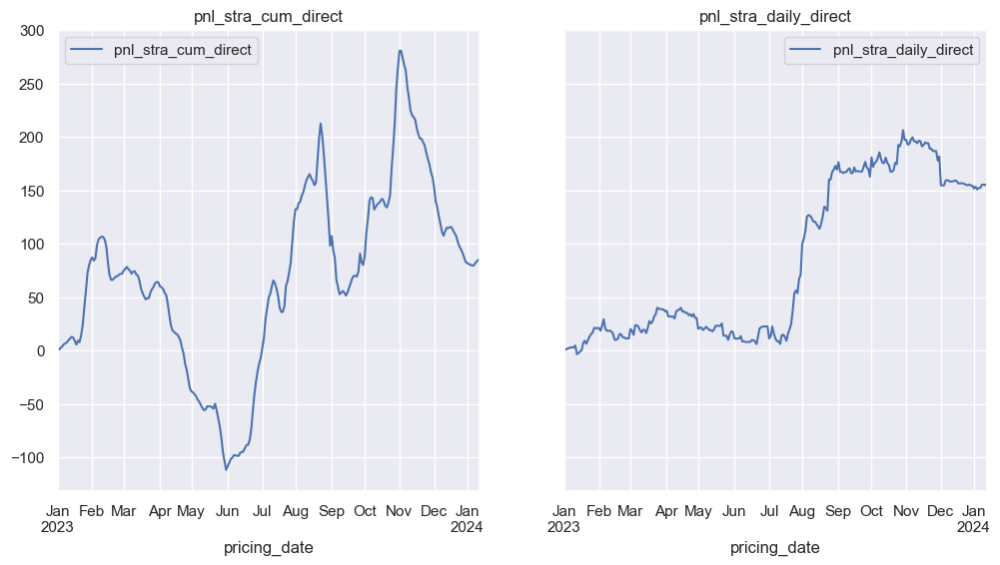

In [62]:
path = 'experiments/test'

if not os.path.exists(path): os.mkdir(path)

path += '/estimators/'
if not os.path.exists(path): os.mkdir(path)

data.interpolate('linear', inplace=True)
data.dropna()

results = get_predictions(data.copy(), path, '2023-01-01', '2023-12-31', use_features=True, n_estimators=100, target_features=['rolling', 'ewm'], use_fe=True)

# + Negative features

In [64]:
columns = data.drop(columns='F380 M2/M3').columns
columns

Index(['ALVARI', 'ARAMCOSG', 'ARAMCOTF', 'ARCENERGY', 'BBEN', 'BPSG',
       'BRIGHTOILSG', 'BUYER1', 'BUYER2', 'CAOSG', 'CARGILLSG', 'CCMA',
       'CHEVRONSG', 'COASTAL', 'ENEOSSG', 'ENOC', 'FREEPTSG', 'GLENCORESG',
       'GPGLOBALSG', 'GULFSG', 'GUNVORSG', 'HL', 'IDEMITSU', 'ITGRES',
       'KAIROS', 'KOCHRI', 'LUKOIL', 'MACQUARIESG', 'MAERSKSG',
       'MERCURIARESOURCES', 'MERCURIASG', 'METS', 'MIPCO', 'P66SG', 'PETCO',
       'PETROCHINA', 'PETROSUMMIT', 'PTT', 'REPSOLSG', 'REXCOMM', 'RGES',
       'SELLER1', 'SIETCO', 'SINOHKPET', 'SINOPECFO', 'SINOPECHKSG', 'SKEISG',
       'SOCAR', 'SUMMITENERGY', 'TOTALSG', 'TRAFI', 'UNIPECSG', 'VITOLSG',
       'WANXIANG', 'ZENROCK', '_rgp_01_sz_3', '_rgp_02_sz_3', '_rgp_03_sz_3',
       '_rgp_04_sz_3', '_rgp_05_sz_3', '_rgp_06_sz_3', '_rgp_07_sz_3',
       '_rgp_08_sz_3', '_rgp_09_sz_3', '_rgp_10_sz_3', '_rgp_11_sz_3',
       'year_sin', 'month_sin', 'day_sin', 'dow_sin', 'year_num', 'month_num',
       'day_num', 'dow_num'],
      dtype='

In [65]:
for col in list(columns):
    data[f'neg_{col}'] = -data[col]

data

,ALVARI,ARAMCOSG,ARAMCOTF,ARCENERGY,BBEN,BPSG,BRIGHTOILSG,BUYER1,BUYER2,CAOSG,...,neg__rgp_10_sz_3,neg__rgp_11_sz_3,neg_year_sin,neg_month_sin,neg_day_sin,neg_dow_sin,neg_year_num,neg_month_num,neg_day_num,neg_dow_num
pricing_date,,,,,,,,,,,,,,,,,,,,,
2017-01-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.172867e-02,-0.500000,-0.897805,-1.000000e+00,-2017,-1,-10,-1
2017-01-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.172867e-02,-0.500000,-0.790776,-1.224647e-16,-2017,-1,-11,-2
2017-01-12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.172867e-02,-0.500000,-0.651372,1.000000e+00,-2017,-1,-12,-3
2017-01-13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.172867e-02,-0.500000,-0.485302,2.449294e-16,-2017,-1,-13,-4
2017-01-16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.172867e-02,-0.500000,0.101168,-0.000000e+00,-2017,-1,-16,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.449294e-16,-0.866025,0.848644,-0.000000e+00,-2024,-2,-26,0
2024-02-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.449294e-16,-0.866025,0.724793,-1.000000e+00,-2024,-2,-27,-1
2024-02-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,2.449294e-16,-0.866025,0.571268,-1.224647e-16,-2024,-2,-28,-2


COLUMNS Index(['ALVARI', 'ARAMCOSG', 'ARAMCOTF', 'ARCENERGY', 'BBEN', 'BPSG',
       'BRIGHTOILSG', 'BUYER1', 'BUYER2', 'CAOSG',
       ...
       'neg__rgp_10_sz_3', 'neg__rgp_11_sz_3', 'neg_year_sin', 'neg_month_sin',
       'neg_day_sin', 'neg_dow_sin', 'neg_year_num', 'neg_month_num',
       'neg_day_num', 'neg_dow_num'],
      dtype='object', length=149)
(570, 148) (570,)
(30, 148) (30,)
(670, 148) (670,)
(30, 148) (30,)
(770, 148) (770,)
(30, 148) (30,)
(870, 148) (870,)
(30, 148) (30,)
(970, 148) (970,)
(30, 148) (30,)
['ALVARI', 'ARAMCOSG', 'BPSG', 'BRIGHTOILSG', 'BUYER1', 'CHEVRONSG', 'COASTAL', 'ENOC', 'FREEPTSG', 'GLENCORESG', 'GUNVORSG', 'HL', 'IDEMITSU', 'ITGRES', 'LUKOIL', 'MACQUARIESG', 'MAERSKSG', 'MERCURIARESOURCES', 'MERCURIASG', 'METS', 'MIPCO', 'P66SG', 'PETROCHINA', 'PETROSUMMIT', 'PTT', 'REPSOLSG', 'SELLER1', 'SIETCO', 'SINOPECFO', 'SINOPECHKSG', 'SOCAR', 'TOTALSG', 'TRAFI', 'VITOLSG', '_rgp_01_sz_3', '_rgp_02_sz_3', '_rgp_03_sz_3', '_rgp_04_sz_3', '_rgp_05_sz_3',

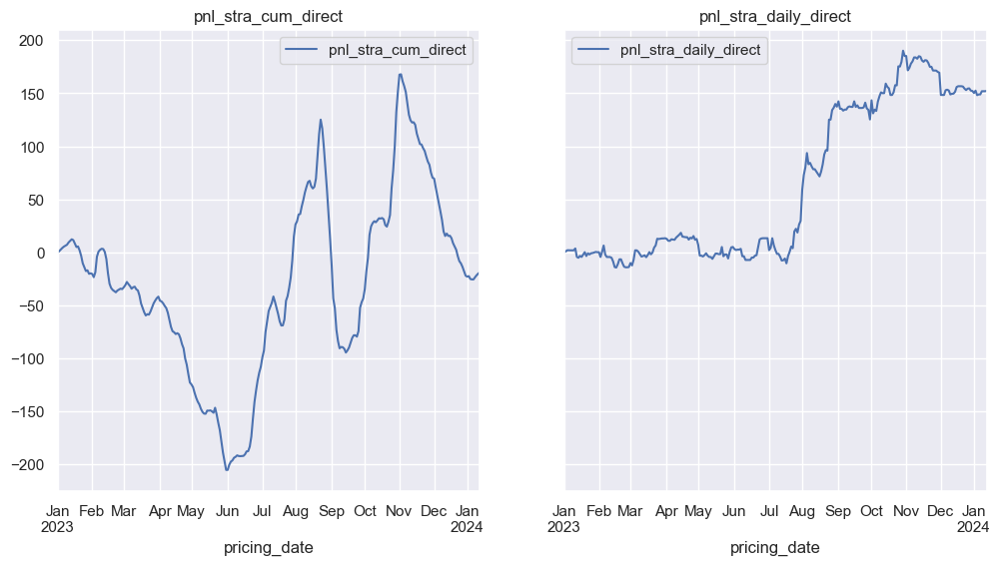

In [66]:
path = 'experiments/test'

if not os.path.exists(path): os.mkdir(path)

path += '/estimators/'
if not os.path.exists(path): os.mkdir(path)

data.interpolate('linear', inplace=True)
data.dropna()

results = get_predictions(data.copy(), path, '2023-01-01', '2023-12-31', use_features=True, n_estimators=100, target_features=['rolling', 'ewm'], use_fe=True)

In [74]:
features = pd.read_csv('data/feature_importances.csv', index_col=0)
features

,columns,values
0,ALVARI,369.420471
1,ARAMCOSG,2928.861816
2,ARAMCOTF,1.289644
3,BPSG,9696.447266
4,BRIGHTOILSG,124.059326
...,...,...
77,neg__rgp_04_sz_3,3586.952393
78,neg__rgp_05_sz_3,156.992218
79,neg__rgp_06_sz_3,22.988914
80,neg__rgp_07_sz_3,592.898926


In [80]:
columns = features[features['values'] > 30]
columns

,columns,values
0,ALVARI,369.420471
1,ARAMCOSG,2928.861816
3,BPSG,9696.447266
4,BRIGHTOILSG,124.059326
5,BUYER1,421.576691
...,...,...
75,neg__rgp_02_sz_3,354.613068
76,neg__rgp_03_sz_3,186.926575
77,neg__rgp_04_sz_3,3586.952393
78,neg__rgp_05_sz_3,156.992218


In [87]:
tf = TargetFeature(path, data, '2023-01-01', '2023-12-31', features=['rolling', 'ewm'])
tf()
targ_features = tf.get_target_feature('2023-01-01', include_past=True)

TargetFeature:               actual_target  predicted_target
pricing_date                                 
2017-01-10             1.50              1.50
2017-01-11             1.30              1.30
2017-01-12             1.70              1.70
2017-01-13             1.85              1.85
2017-01-16             2.00              2.00
...                     ...               ...
2024-02-26            -0.30             -0.30
2024-02-27            -0.30             -0.30
2024-02-28            -0.30             -0.30
2024-02-29            -0.30             -0.30
2024-03-01            -0.30             -0.30

[1864 rows x 2 columns]
TargetFeature updated:               actual_target  predicted_target  actual_rolling  \
pricing_date                                                    
2017-01-10             1.50              1.50             NaN   
2017-01-11             1.30              1.30             NaN   
2017-01-12             1.70              1.70             NaN   
2017-01-13    

In [89]:
scaler_target = tf.scaler

In [90]:
from explainerdashboard import RegressionExplainer, ExplainerDashboard
import xgboost as xgb

path = 'experiments/test'

if not os.path.exists(path): os.mkdir(path)

path += '/estimators/'
if not os.path.exists(path): os.mkdir(path)

data.interpolate('linear', inplace=True)
data.dropna()

# model_name = 'experiments/models/model-full-cols=71_estim=100.model'

model = results['model']

scaler = MinMaxScaler()

X_test = data.loc['2023-01-01':'2024-01-01'].drop(columns='F380 M2/M3')[columns['columns']]
y_test = data.loc['2023-01-01':'2024-01-01']['F380 M2/M3']

scaler.fit(X_test)
X_test = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns, index=X_test.index)

pred_target = pd.read_csv('experiments/test/estimators/complete_target_feature_df.csv')
pred_target.pricing_date = pd.to_datetime(pred_target.pricing_date)
pred_target.set_index('pricing_date', inplace=True)

X_test[['actual_rolling', 'actual_ewm']] = scaler_target.transform(pred_target.loc['2023-01-01':'2024-01-01'][['actual_rolling', 'actual_ewm']])

X_test

,ALVARI,ARAMCOSG,BPSG,BRIGHTOILSG,BUYER1,CHEVRONSG,COASTAL,ENOC,FREEPTSG,GLENCORESG,...,neg_TRAFI,neg_VITOLSG,neg__rgp_01_sz_3,neg__rgp_02_sz_3,neg__rgp_03_sz_3,neg__rgp_04_sz_3,neg__rgp_05_sz_3,neg__rgp_07_sz_3,actual_rolling,actual_ewm
pricing_date,,,,,,,,,,,,,,,,,,,,,
2023-01-02,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.393529,0.745434,0.455623,0.675018,0.576964,0.634283,0.533551,0.388371,0.195641,0.189927
2023-01-03,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.512995,0.757435,0.495844,0.634400,0.529881,0.634283,0.533551,0.388371,0.190281,0.190037
2023-01-04,0.0,0.0,0.222222,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.578728,0.756095,0.476882,0.621744,0.513389,0.614615,0.533551,0.388371,0.182240,0.189216
2023-01-05,0.0,0.0,0.250545,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.652210,0.701481,0.511654,0.622185,0.523763,0.615632,0.533551,0.388371,0.173843,0.188263
2023-01-06,0.0,0.0,0.250545,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.603238,0.358089,0.575533,0.523763,0.636487,0.533551,0.388371,0.165803,0.188018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-26,0.0,0.0,0.160321,0.0,0.0,0.0,0.0,0.0,0.0,0.366422,...,0.620315,0.689103,0.931874,0.699919,0.702882,0.460309,0.533551,0.388371,0.230570,0.295670
2023-12-27,0.0,0.0,0.186111,0.0,0.0,0.0,0.0,0.0,0.0,0.366422,...,0.620315,0.744916,0.917132,0.855180,0.772398,0.514225,0.556394,0.388371,0.231999,0.295710
2023-12-28,0.0,0.0,0.180037,0.0,0.0,0.0,0.0,0.0,0.0,0.083333,...,0.617840,0.845238,1.000000,0.819860,0.794033,0.628671,0.600993,0.388371,0.234143,0.296303


In [91]:
explainer = RegressionExplainer(model, X_test, y_test)
ExplainerDashboard(explainer, depth=10).run()

Changing class type to XGBRegressionExplainer...
Generating self.shap_explainer = shap.TreeExplainer(model)
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
Generating layout...
Calculating shap values...
Calculating predictions...
Calculating residuals...
Calculating absolute residuals...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is the number of trees, L is the maximum number of leaves in any tree and D the maximal depth of any tree. So reducing these will speed up the calculation.
Generating xgboost model dump...
Calculating dependencies...
Calculating importances...
Calculating ShadowDecTree for each individual decision tree...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExpla

ConnectionError: HTTPConnectionPool(host='0.0.0.0', port=8050): Max retries exceeded with url: /_alive_ba121b7a-4f4b-47ad-a634-8a8ba389fc61 (Caused by NewConnectionError('<urllib3.connection.HTTPConnection object at 0x0000018344F03460>: Failed to establish a new connection: [WinError 10049] Требуемый адрес для своего контекста неверен'))

                 col  contribution     value
0             ALVARI     -0.004005  0.000000
1           ARAMCOSG     -0.001020  0.000000
3        BRIGHTOILSG     -0.000149  0.000000
4             BUYER1     -0.002101  0.000000
5          CHEVRONSG      0.000223  0.000000
..               ...           ...       ...
63  neg__rgp_01_sz_3     -0.002261  0.582677
64  neg__rgp_02_sz_3     -0.007874  0.676152
65  neg__rgp_03_sz_3     -0.002820  0.393492
66  neg__rgp_04_sz_3      0.000986  0.576551
67  neg__rgp_05_sz_3      0.000287  0.533551

[61 rows x 3 columns]
                 col  contribution     value
0             ALVARI     -0.004005  0.000000
1           ARAMCOSG     -0.001020  0.000000
3        BRIGHTOILSG     -0.000149  0.000000
4             BUYER1     -0.002101  0.000000
5          CHEVRONSG      0.000223  0.000000
..               ...           ...       ...
63  neg__rgp_01_sz_3     -0.002261  0.582677
64  neg__rgp_02_sz_3     -0.007874  0.676152
65  neg__rgp_03_sz_3     -0.0028

[2024-02-06 15:58:54,414] ERROR in app: Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "c:\Users\dinar\miniconda3\envs\finapp\lib\site-packages\flask\app.py", line 1463, in wsgi_app
    response = self.full_dispatch_request()
  File "c:\Users\dinar\miniconda3\envs\finapp\lib\site-packages\flask\app.py", line 872, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "c:\Users\dinar\miniconda3\envs\finapp\lib\site-packages\flask\app.py", line 870, in full_dispatch_request
    rv = self.dispatch_request()
  File "c:\Users\dinar\miniconda3\envs\finapp\lib\site-packages\flask\app.py", line 855, in dispatch_request
    return self.ensure_sync(self.view_functions[rule.endpoint])(**view_args)  # type: ignore[no-any-return]
  File "c:\Users\dinar\miniconda3\envs\finapp\lib\site-packages\dash\dash.py", line 1310, in dispatch
    ctx.run(
  File "c:\Users\dinar\miniconda3\envs\finapp\lib\site-packages\dash\_callback.py", line 442, in add_co

                 col  contribution     value
0             ALVARI     -0.009501  0.000000
1           ARAMCOSG     -0.001182  0.000000
2               BPSG      0.007343  0.274480
3        BRIGHTOILSG     -0.000150  0.000000
4             BUYER1     -0.001801  0.000000
..               ...           ...       ...
64  neg__rgp_02_sz_3     -0.004655  0.774798
65  neg__rgp_03_sz_3      0.006969  0.677248
66  neg__rgp_04_sz_3      0.000599  0.643438
67  neg__rgp_05_sz_3     -0.001215  0.500510
68  neg__rgp_07_sz_3     -0.013192  0.422655

[61 rows x 3 columns]                 col  contribution     value
0             ALVARI     -0.009501  0.000000
1           ARAMCOSG     -0.001182  0.000000
2               BPSG      0.007343  0.274480
3        BRIGHTOILSG     -0.000150  0.000000
4             BUYER1     -0.001801  0.000000
..               ...           ...       ...
64  neg__rgp_02_sz_3     -0.004655  0.774798
65  neg__rgp_03_sz_3      0.006969  0.677248
66  neg__rgp_04_sz_3      0.00059

In [83]:
y_test

pricing_date
2023-01-02    0.500
2023-01-03   -0.500
2023-01-04   -1.000
2023-01-05   -1.100
2023-01-06   -0.750
              ...  
2023-12-26    2.950
2023-12-27    3.150
2023-12-28    3.450
2023-12-29    3.550
2024-01-01    3.275
Name: F380 M2/M3, Length: 261, dtype: float64

                 col  contribution       value
0             ALVARI     -0.004812    0.000000
1           ARAMCOSG     -0.000836    0.000000
2               BPSG      0.029983    0.000000
3        BRIGHTOILSG     -0.000145    0.000000
4             BUYER1     -0.004738    0.000000
..               ...           ...         ...
65  neg__rgp_03_sz_3     -0.000636 -210.000000
66  neg__rgp_04_sz_3      0.067117 -493.333333
67  neg__rgp_05_sz_3     -0.010496   45.000000
68  neg__rgp_07_sz_3     -0.003580   -0.000000
70        actual_ewm     -0.013844    0.547606

[61 rows x 3 columns]
                 col  contribution       value
0             ALVARI     -0.004812    0.000000
1           ARAMCOSG     -0.000836    0.000000
2               BPSG      0.029983    0.000000
3        BRIGHTOILSG     -0.000145    0.000000
4             BUYER1     -0.004738    0.000000
..               ...           ...         ...
65  neg__rgp_03_sz_3     -0.000636 -210.000000
66  neg__rgp_04_sz_3      0.067117 -4